In [1]:
import numpy as np
import imageio
from skimage.color import rgb2hsv, hsv2rgb
import sys
import matplotlib.pyplot as plt

In [2]:
from project import *

# Main execution

In [3]:
def quick_setup(img_name_canvas, n_imgs, tile_names, x, y, division_method,
                ux, uy, mean, std, fix_black, alter_color_method, save, out_name):
    
    # reads image from directory and changes the data type, also it ignores the alpha channel in png format
    canvas_img = imageio.imread('../images/'+img_name_canvas)[:, :, 0:3].astype(np.float)
    tile_imgs = []
    for name in tile_names:
        tile_imgs.append(imageio.imread('../images/'+name)[:, :, 0:3].astype(np.float))

    # creates mosaic
    out_img = mosaic_transform(canvas_img, tile_imgs, n_imgs=n_imgs, resolution=(x, y),
               division_method=division_method,rand_parameters=(ux, uy, mean, std),
               fix_black=fix_black, alter_color_method=alter_color_method)
    out_img = out_img.astype(np.uint8)
    
    if save:
        imageio.imwrite('../output_images/'+out_name, out_img)
    
    print("Finished.")
    
    return canvas_img.astype(np.uint8), tile_imgs, out_img

# Method 1 example

In [4]:
img_name_canvas = "butterfly.jpg"  # Image to be transformed into mosaic
n_imgs = 1                         # Number of tile images to compose the mosaic
tile_names = ["tile4.jpg"]         # Tile images
x, y = (80, 120)                   # Mosaic resolution -> 80x120 tile images
division_method = 1                # Uniform mosaic
fix_black = 1                      # Fix black border
alter_color_method = 1             # RGB color processing
save = 1                           # If the mosaic image will be saved after the execution
out_name = "out_butterfly.jpg"     # Output image name

canvas_img, tile_imgs, out_img = quick_setup(img_name_canvas, n_imgs, tile_names, x, y, division_method,
                      ux=0, uy=0, mean=0, std=0, fix_black=fix_black, alter_color_method=alter_color_method,
                      save=save, out_name=out_name)

Creating mosaic...
number of unique divison:  4 , total divisions:  9600
Creating tile images...
[                                                  ------------------------------------------------]
Composing the Mosaic...
[                                                  --------------------------------------------------]
Finished.


Text(0.5, 1.0, 'Tile image')

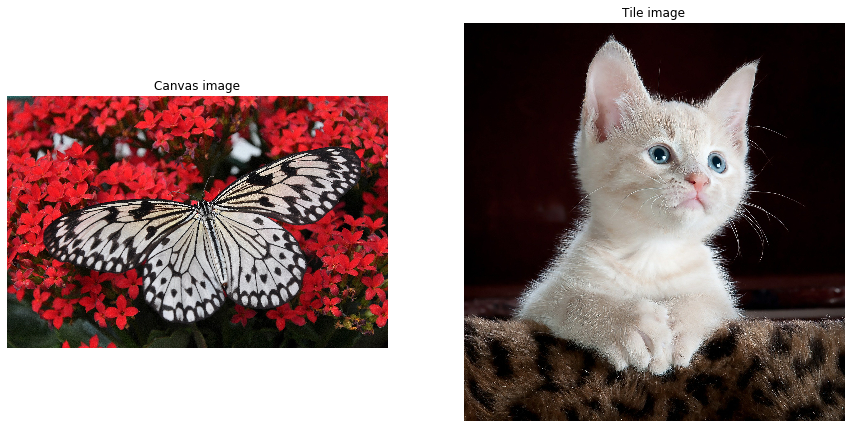

In [69]:
plt.figure(figsize=(15, 15))

plt.subplot(121)
plt.axis("off")
plt.imshow(canvas_img)
plt.title("Canvas image")

plt.subplot(122)
plt.axis("off")
plt.imshow(tile_imgs[0].astype(np.uint8))
plt.title("Tile image")

Text(0.5, 1.0, 'Mosaic')

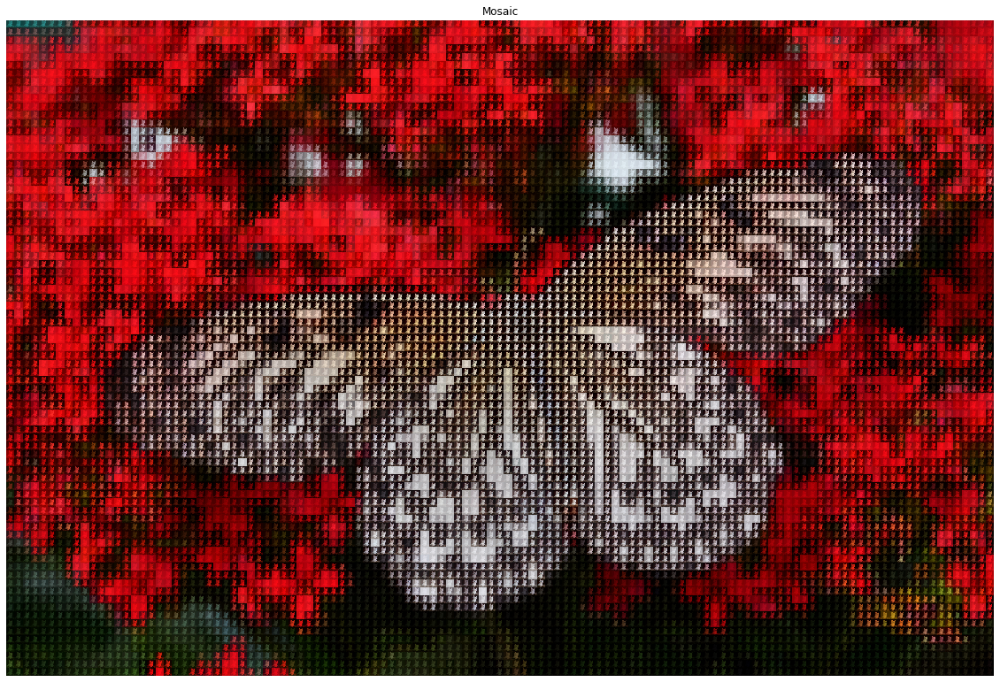

In [5]:
plt.figure(figsize=(20, 20))

plt.axis("off")
plt.imshow(out_img)
plt.title("Mosaic")

Text(0.5, 1.0, 'Section of the resulting mosaic')

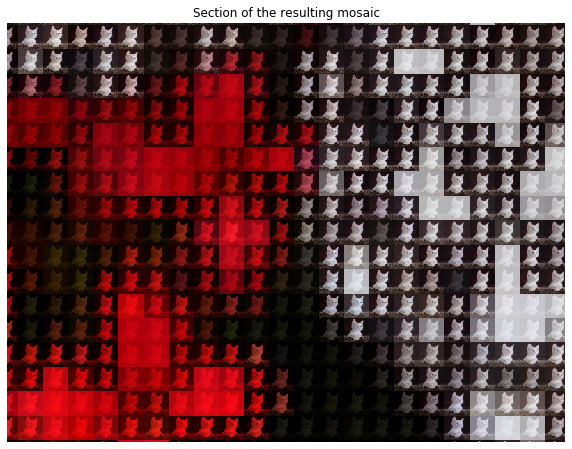

In [6]:
plt.figure(figsize=(10, 10))

plt.axis("off")
plt.imshow(out_img[1900:2501, 1100:1901, :])
plt.title("Section of the resulting mosaic")

# Method 2 example

In [7]:
img_name_canvas = "tartaruga.jpg"  # Image to be transformed into mosaic
n_imgs = 5                         # Number of tile images to compose the mosaic
tile_names = ["tile1.jpg",         # Tile images
              "tile2.jpg",
              "tile3.jpg",
              "tile5.jpg",
              "tile6.jpg"]         
x, y = (50, 75)                    # Mosaic resolution -> 80x120 tile images
division_method = 2                # Uniform mosaic
fix_black = 1                      # Fix black border
alter_color_method = 1             # RGB color processing
ux = 10
uy = 10
mean = 100
std = 25
save = 1
out_name = "out_tartaruga.jpg"

canvas_img, tile_imgs, out_img = quick_setup(img_name_canvas, n_imgs, tile_names, x, y, division_method,
                      ux, uy, mean, std, fix_black, alter_color_method, save, out_name)

Creating mosaic...
number of unique divison:  121 , total divisions:  3750
Creating tile images...
[                                                  ------------------------------------------------------------]
Composing the Mosaic...
[                                                  --------------------------------------------------]
Finished.


Text(0.5, 1.0, 'Canvas image')

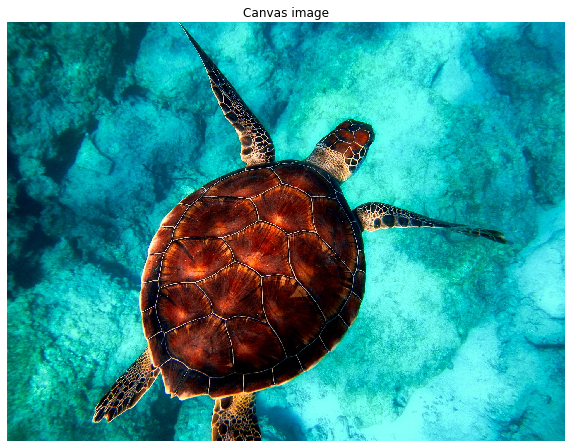

In [91]:
plt.figure(figsize=(10, 10))

plt.axis("off")
plt.imshow(canvas_img)
plt.title("Canvas image")

Text(0.5, 1.0, 'Tile image 5')

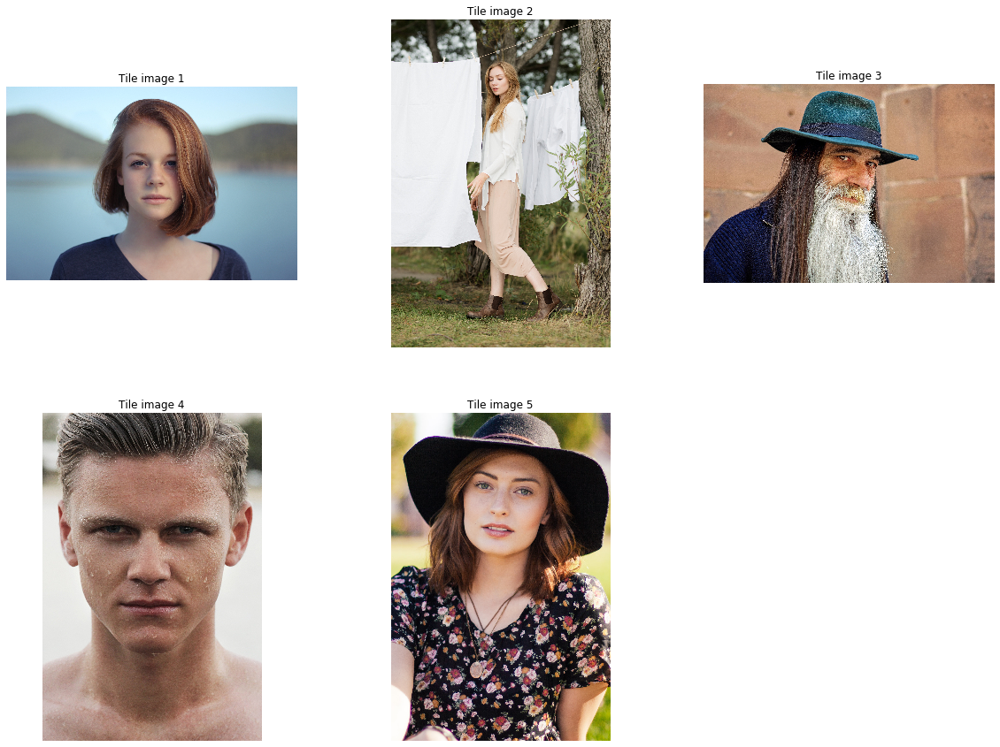

In [101]:
plt.figure(figsize=(20, 15))

plt.subplot(231); plt.axis("off"); plt.imshow(tile_imgs[0].astype(np.uint8)); plt.title("Tile image 1")
plt.subplot(232); plt.axis("off"); plt.imshow(tile_imgs[1].astype(np.uint8)); plt.title("Tile image 2")
plt.subplot(233); plt.axis("off"); plt.imshow(tile_imgs[2].astype(np.uint8)); plt.title("Tile image 3")
plt.subplot(234); plt.axis("off"); plt.imshow(tile_imgs[3].astype(np.uint8)); plt.title("Tile image 4")
plt.subplot(235); plt.axis("off"); plt.imshow(tile_imgs[4].astype(np.uint8)); plt.title("Tile image 5")

Text(0.5, 1.0, 'Mosaic')

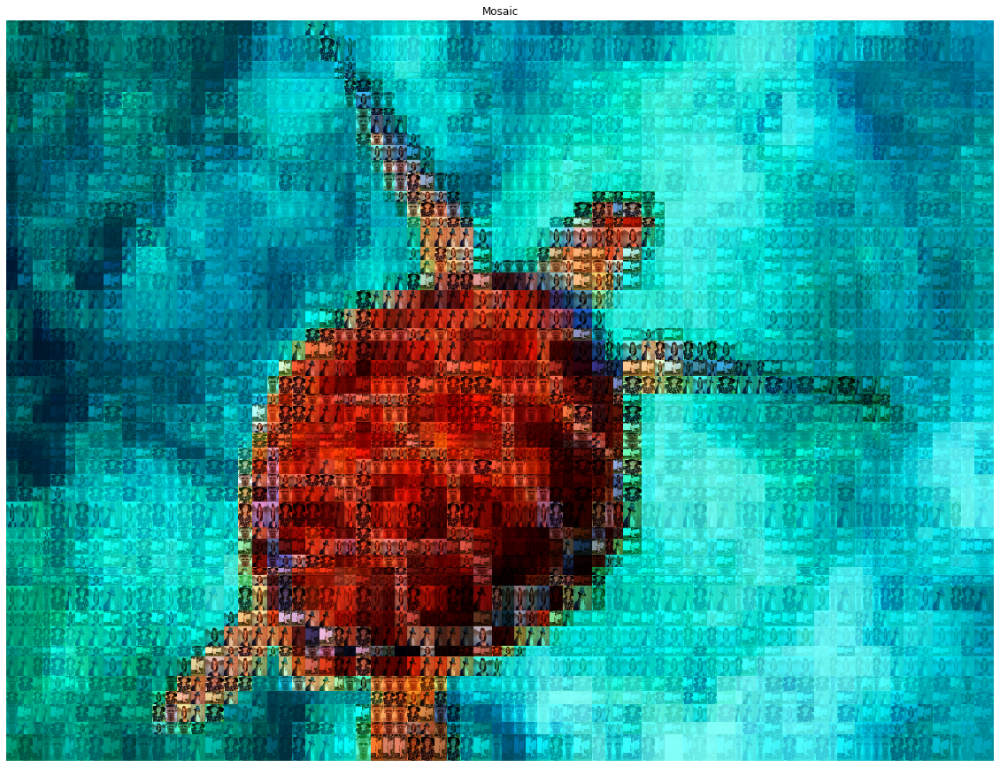

In [8]:
plt.figure(figsize=(20, 20))

plt.axis("off")
plt.imshow(out_img)
plt.title("Mosaic")

Text(0.5, 1.0, 'Section of the resulting mosaic')

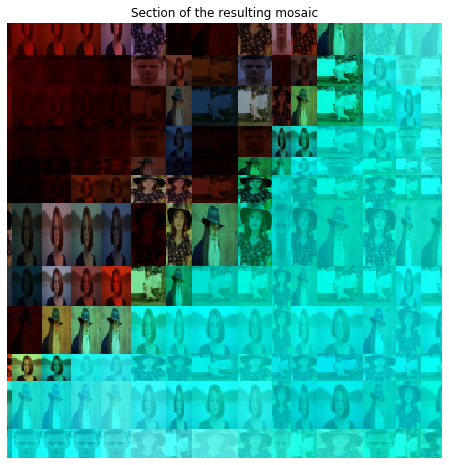

In [9]:
plt.figure(figsize=(8, 8))

plt.axis("off")
plt.imshow(out_img[1000:1351, 1000:1351, :])
plt.title("Section of the resulting mosaic")

# Method 3 example using HSV

In [10]:
img_name_canvas = "grafitti2.jpg"  # Image to be transformed into mosaic
n_imgs = 3                         # Number of tile images to compose the mosaic
tile_names = ["lapis.jpg",         # Tile images
              "lapis2.jpg",
              "lapis3.png"]         
x, y = (75, 100)                   # Mosaic resolution -> 80x120 tile images
division_method = 3                # Uniform mosaic
fix_black = 1                      # Fix black border
alter_color_method = 2             # HSV color processing
ux = 15
uy = 15
mean = 100
std = 25
save = 1
out_name = "out_grafitti.jpg"

canvas_img, tile_imgs, out_img = quick_setup(img_name_canvas, n_imgs, tile_names, x, y, division_method,
                      ux, uy, mean, std, fix_black, alter_color_method, save, out_name)

Creating mosaic...
number of unique divison:  519 , total divisions:  7500
Creating tile images...
[                                                  ---------------------------------------------------]
Composing the Mosaic...
[                                                  --------------------------------------------------]
Finished.


Text(0.5, 1.0, 'Canvas image')

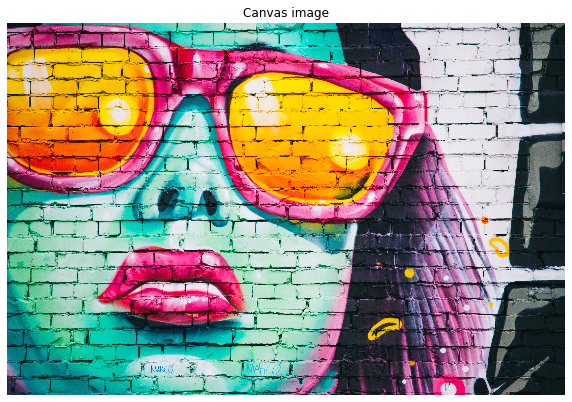

In [119]:
plt.figure(figsize=(10, 10))

plt.axis("off")
plt.imshow(canvas_img)
plt.title("Canvas image")

Text(0.5, 1.0, 'Tile image 3')

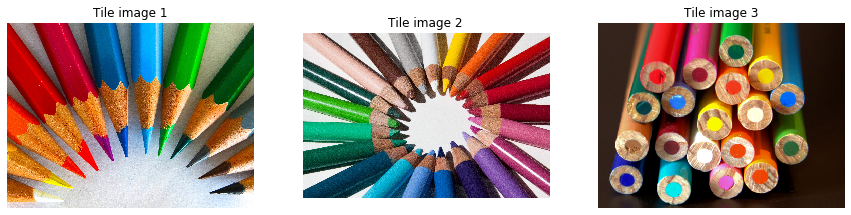

In [109]:
plt.figure(figsize=(15, 10))

plt.subplot(131); plt.axis("off"); plt.imshow(tile_imgs[0].astype(np.uint8)); plt.title("Tile image 1")
plt.subplot(132); plt.axis("off"); plt.imshow(tile_imgs[1].astype(np.uint8)); plt.title("Tile image 2")
plt.subplot(133); plt.axis("off"); plt.imshow(tile_imgs[2].astype(np.uint8)); plt.title("Tile image 3")

Text(0.5, 1.0, 'Mosaic')

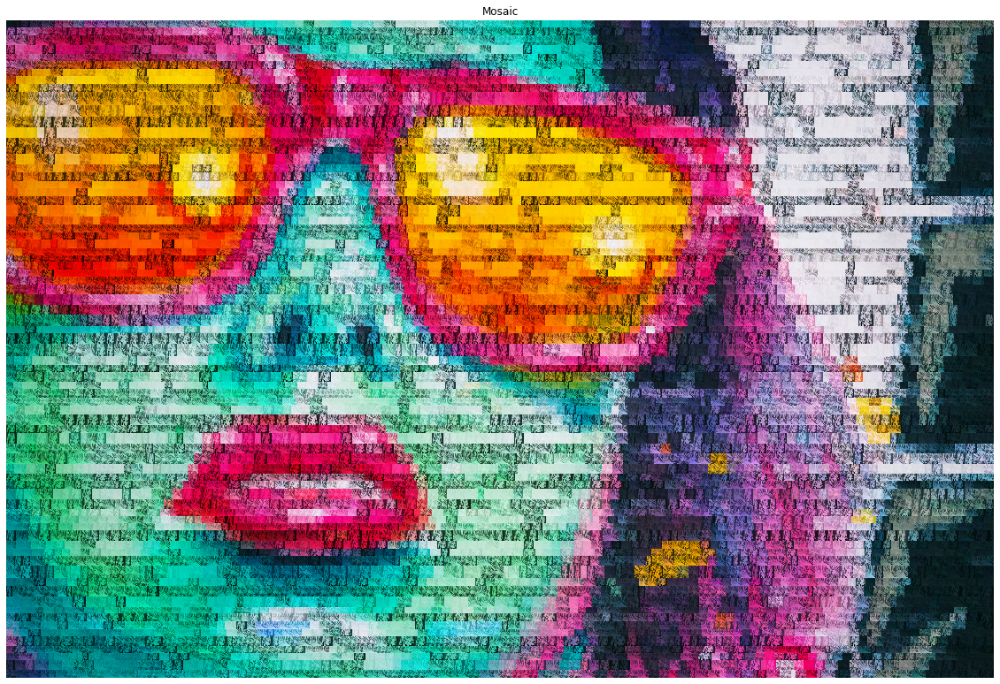

In [11]:
plt.figure(figsize=(20, 20))

plt.axis("off")
plt.imshow(out_img)
plt.title("Mosaic")

Text(0.5, 1.0, 'Section of the resulting mosaic')

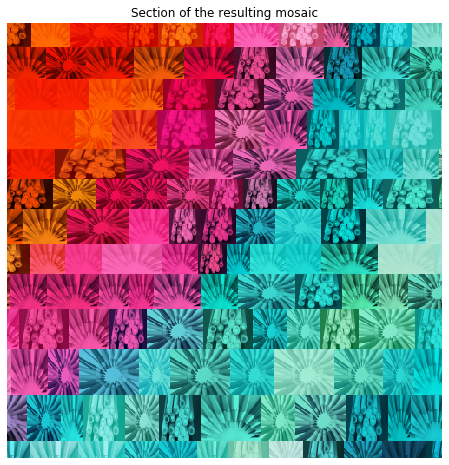

In [12]:
plt.figure(figsize=(8, 8))

plt.axis("off")
plt.imshow(out_img[1000:1501, 1000:1501, :])
plt.title("Section of the resulting mosaic")

# Method 3 example using RGB

In [13]:
img_name_canvas = "airport.jpg"    # Image to be transformed into mosaic
n_imgs = 4                         # Number of tile images to compose the mosaic
tile_names = ["skydiving.jpg",     # Tile images
              "mammal.jpg",
              "tile7.jpg",
              "tile9.jpg"]         
x, y = (100, 160)                  # Mosaic resolution -> 80x120 tile images
division_method = 3                # Uniform mosaic
fix_black = 1                      # Fix black border
alter_color_method = 1             # RGB color processing
ux = 10
uy = 10
mean = 100
std = 25
save = 1
out_name = "out_airport.jpg"

canvas_img, tile_imgs, out_img = quick_setup(img_name_canvas, n_imgs, tile_names, x, y, division_method,
                      ux, uy, mean, std, fix_black, alter_color_method, save, out_name)

Creating mosaic...
number of unique divison:  325 , total divisions:  16000
Creating tile images...
[                                                  ------------------------------------------------------]
Composing the Mosaic...
[                                                  --------------------------------------------------]
Finished.


Text(0.5, 1.0, 'Canvas image')

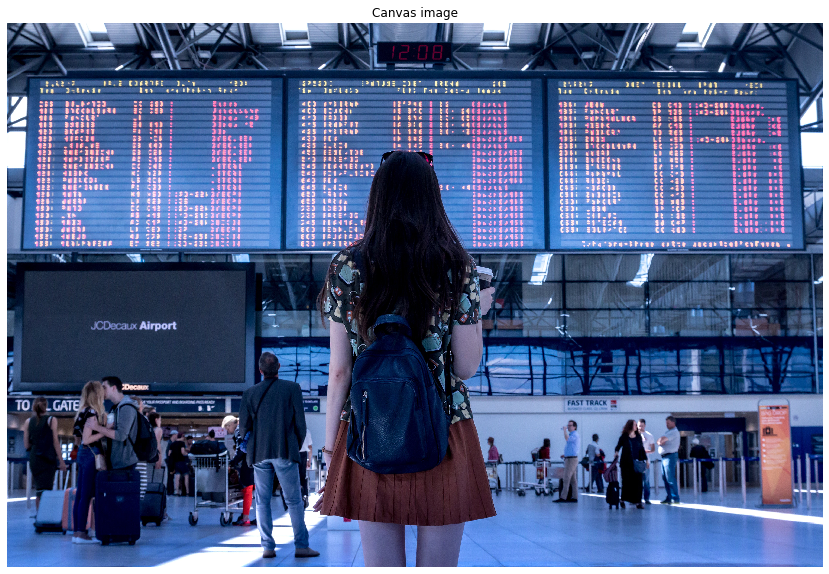

In [126]:
plt.figure(figsize=(16, 10))

plt.axis("off")
plt.imshow(canvas_img)
plt.title("Canvas image")

Text(0.5, 1.0, 'Tile image 4')

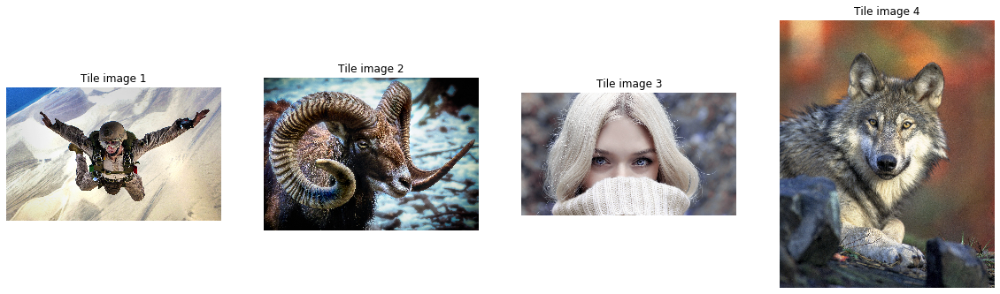

In [129]:
plt.figure(figsize=(20, 15))

plt.subplot(141); plt.axis("off"); plt.imshow(tile_imgs[0].astype(np.uint8)); plt.title("Tile image 1")
plt.subplot(142); plt.axis("off"); plt.imshow(tile_imgs[1].astype(np.uint8)); plt.title("Tile image 2")
plt.subplot(143); plt.axis("off"); plt.imshow(tile_imgs[2].astype(np.uint8)); plt.title("Tile image 3")
plt.subplot(144); plt.axis("off"); plt.imshow(tile_imgs[3].astype(np.uint8)); plt.title("Tile image 4")

Text(0.5, 1.0, 'Mosaic')

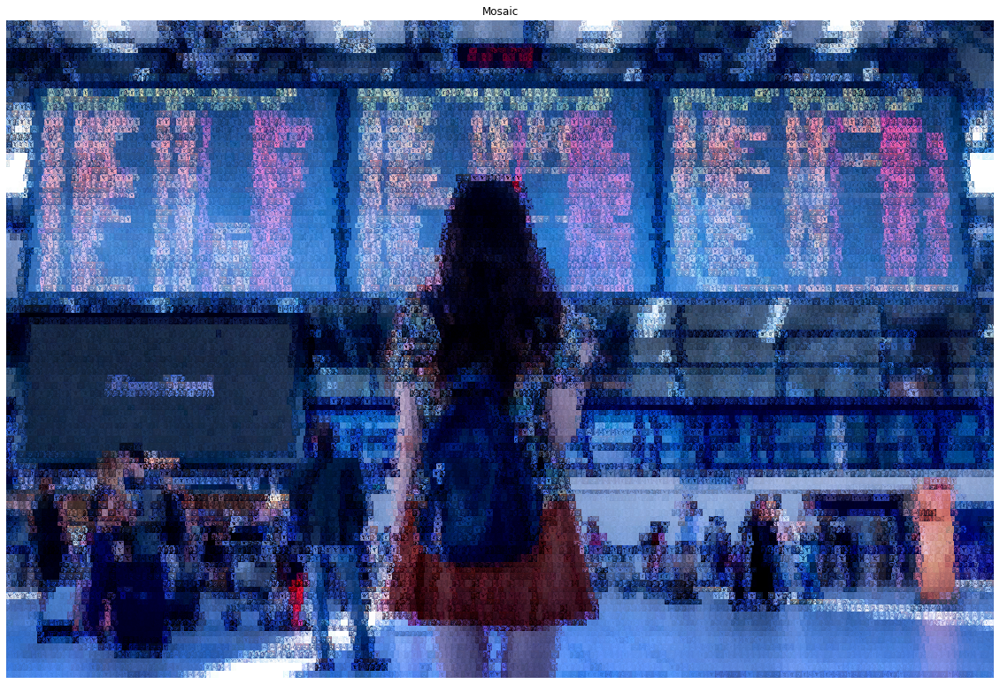

In [14]:
plt.figure(figsize=(20, 16))

plt.axis("off")
plt.imshow(out_img)
plt.title("Mosaic")

Text(0.5, 1.0, 'Section of the resulting mosaic')

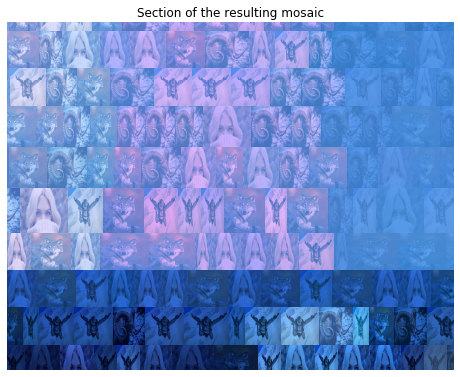

In [15]:
plt.figure(figsize=(8, 8))

plt.axis("off")
plt.imshow(out_img[1250:1601, 1250:1701, :])
plt.title("Section of the resulting mosaic")

# Method 4 example

In [16]:
img_name_canvas = "arara1.jpg"  # Image to be transformed into mosaic
n_imgs = 6                         # Number of tile images to compose the mosaic
tile_names = ["arara2.jpg",         # Tile images
              "dogs.jpg",
              "tile1.jpg",
              "tile5.jpg",
              "cat.jpg",
              "tile9.jpg"]         
x, y = (75, 100)                   # Mosaic resolution -> 80x120 tile images
division_method = 4                # Uniform mosaic
fix_black = 1                      # Fix black border
alter_color_method = 2             # HSV color processing
ux = 10
uy = 10
mean = 100
std = 25
save = 1
out_name = "out_arara.jpg"

canvas_img, tile_imgs, out_img = quick_setup(img_name_canvas, n_imgs, tile_names, x, y, division_method,
                      ux, uy, mean, std, fix_black, alter_color_method, save, out_name)

Creating mosaic...
number of unique divison:  2233 , total divisions:  7500
Creating tile images...
[                                                  -------------------------------------------------]
Composing the Mosaic...
[                                                  --------------------------------------------------]
Finished.


Text(0.5, 1.0, 'Canvas image')

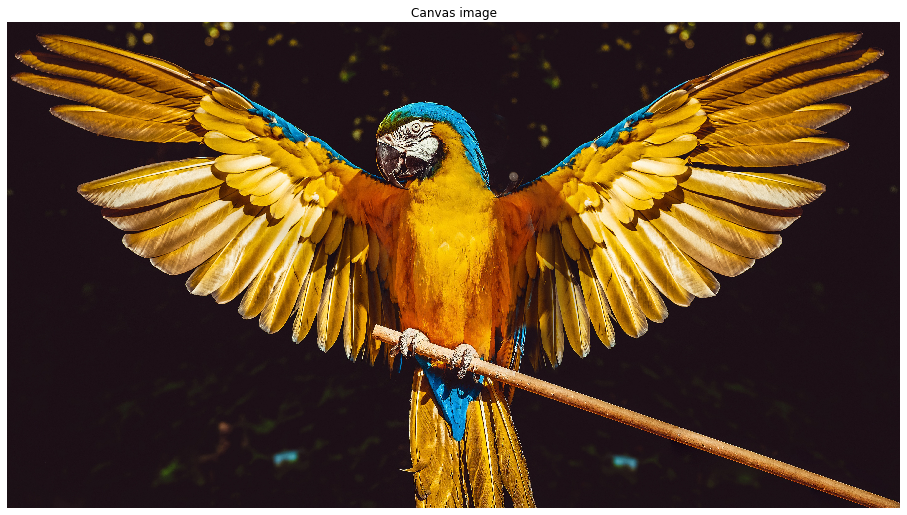

In [148]:
plt.figure(figsize=(16, 10))

plt.axis("off")
plt.imshow(canvas_img)
plt.title("Canvas image")

Text(0.5, 1.0, 'Tile image 4')

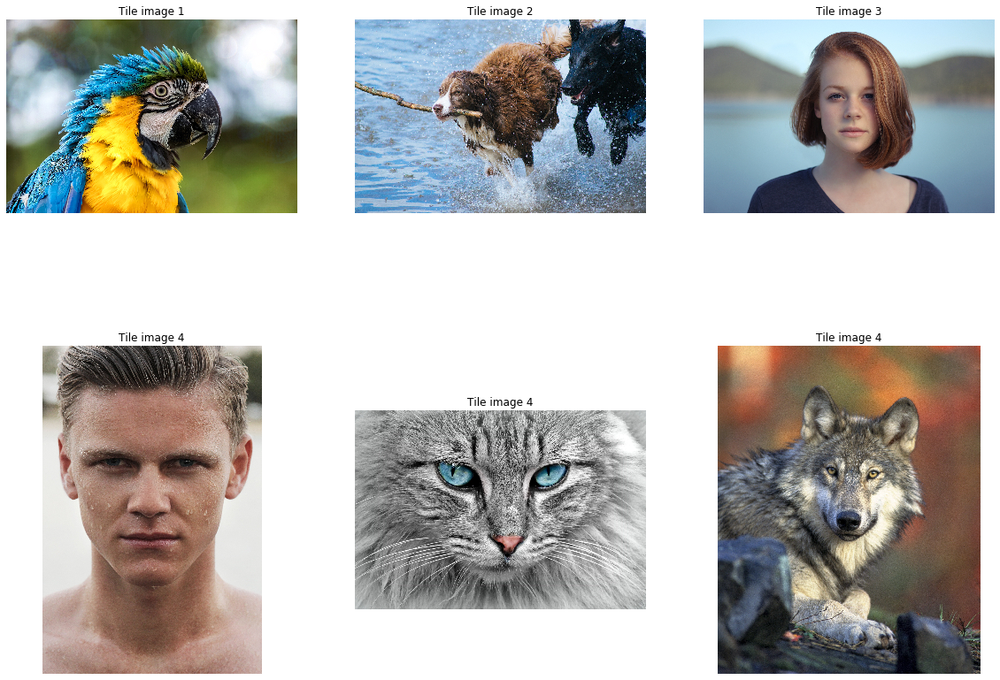

In [149]:
plt.figure(figsize=(20, 15))

plt.subplot(231); plt.axis("off"); plt.imshow(tile_imgs[0].astype(np.uint8)); plt.title("Tile image 1")
plt.subplot(232); plt.axis("off"); plt.imshow(tile_imgs[1].astype(np.uint8)); plt.title("Tile image 2")
plt.subplot(233); plt.axis("off"); plt.imshow(tile_imgs[2].astype(np.uint8)); plt.title("Tile image 3")
plt.subplot(234); plt.axis("off"); plt.imshow(tile_imgs[3].astype(np.uint8)); plt.title("Tile image 4")
plt.subplot(235); plt.axis("off"); plt.imshow(tile_imgs[4].astype(np.uint8)); plt.title("Tile image 4")
plt.subplot(236); plt.axis("off"); plt.imshow(tile_imgs[5].astype(np.uint8)); plt.title("Tile image 4")

Text(0.5, 1.0, 'Mosaic')

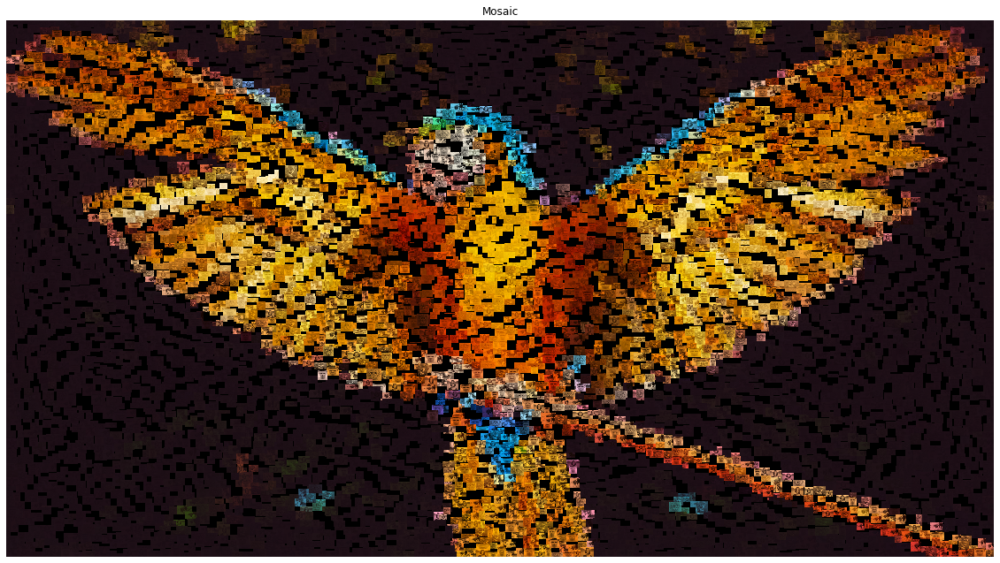

In [17]:
plt.figure(figsize=(20, 16))

plt.axis("off")
plt.imshow(out_img)
plt.title("Mosaic")

Text(0.5, 1.0, 'Section of the resulting mosaic')

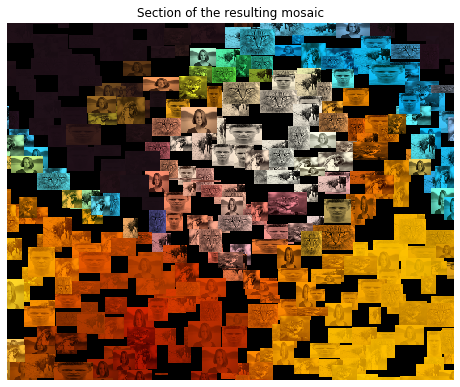

In [18]:
plt.figure(figsize=(8, 8))

plt.axis("off")
plt.imshow(out_img[500:1300, 2000:3000, :])
plt.title("Section of the resulting mosaic")

# Comparison between RGB and HSV processing

In [38]:
img_name_canvas = "piano.jpg"    
n_imgs = 5                         
tile_names = ["arara2.jpg",        
              "grafitti1.jpg",
              "grafitti2.jpg",
              "lapis3.png",
              "lizard.jpg"]         
x, y = (70, 105)                  
division_method = 3                
fix_black = 1                      
alter_color_method = 1  # RGB color processing
ux = 10
uy = 10
mean = 100
std = 25
save = 1
out_name = "out_rgb.jpg"

canvas_img, tile_imgs, out_img_rgb = quick_setup(img_name_canvas, n_imgs, tile_names, x, y, division_method,
                      ux, uy, mean, std, fix_black, alter_color_method, save, out_name)

Creating mosaic...
number of unique divison:  374 , total divisions:  7350
Creating tile images...
[                                                  -----------------------------------------------------]
Composing the Mosaic...
[                                                  --------------------------------------------------]
Finished.


In [39]:
alter_color_method = 2  # HSV color processing
out_name = "out_hsv.jpg"

out_img_hsv = quick_setup(img_name_canvas, n_imgs, tile_names, x, y, division_method,
                      ux, uy, mean, std, fix_black, alter_color_method, save, out_name)[2]

Creating mosaic...
number of unique divison:  385 , total divisions:  7350
Creating tile images...
[                                                  ------------------------------------------------]
Composing the Mosaic...
[                                                  --------------------------------------------------]
Finished.


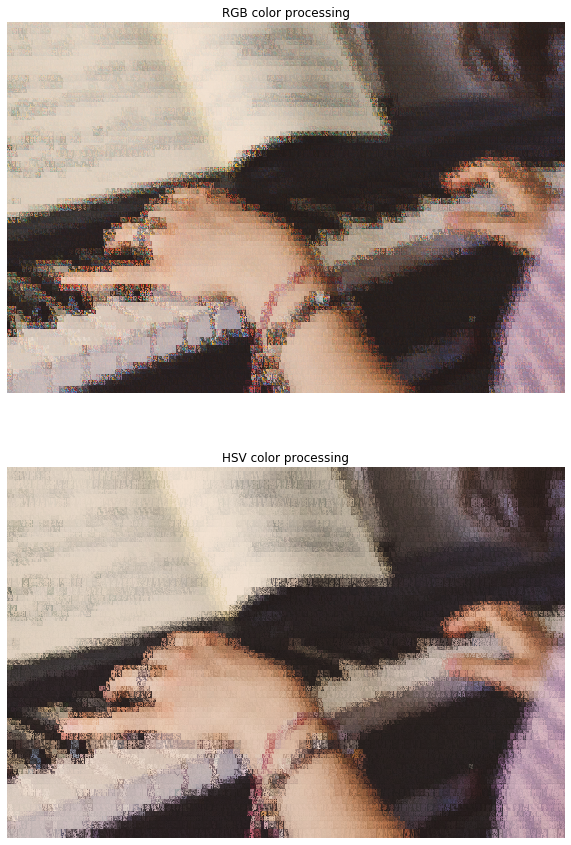

In [40]:
plt.figure(figsize=(30, 15))

plt.subplot(211); plt.axis('off'); plt.title('RGB color processing'); plt.imshow(out_img_rgb)
plt.subplot(212); plt.axis('off'); plt.title('HSV color processing'); plt.imshow(out_img_hsv)

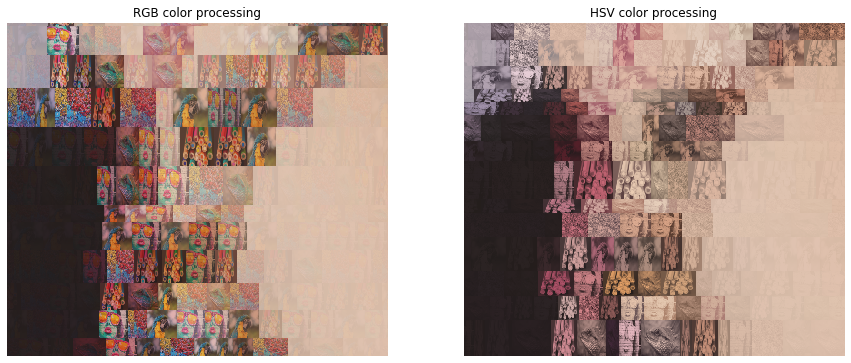

In [53]:
plt.figure(figsize=(15, 15))

plt.subplot(121)
plt.axis('off')
plt.title('RGB color processing')
plt.imshow(out_img_rgb[3000:3700, 2300:3100, :])

plt.subplot(122); plt.axis('off')
plt.title('HSV color processing')
plt.imshow(out_img_hsv[3000:3700, 2300:3100, :])